In [20]:
import collections
import datetime
import fluidsynth
import glob
import numpy as np
import pathlib
import pandas as pd
import pretty_midi
import seaborn as sns
import tensorflow as tf

from IPython import display
from matplotlib import pyplot as plt
from typing import Optional
import re
import os

In [2]:
seed = 42
tf.random.set_seed(seed)
np.random.seed(seed)

# Sampling rate for audio playback
_SAMPLING_RATE = 16000

In [3]:
data_dir = pathlib.Path('data/maestro-v2.0.0')
if not data_dir.exists():
  tf.keras.utils.get_file(
      'maestro-v2.0.0-midi.zip',
      origin='https://storage.googleapis.com/magentadata/datasets/maestro/v2.0.0/maestro-v2.0.0-midi.zip',
      extract=True,
      cache_dir='.', cache_subdir='data',
  )

In [4]:
filenames = glob.glob(str(data_dir/'**/*.mid*'))
print('Number of files:', len(filenames))

Number of files: 1282


In [5]:
import IPython


example = filenames[0]

print(f"Example song: {example}")

def display_audio(pm: str | pretty_midi.PrettyMIDI):
    
    if isinstance(pm, str):
        pm = pretty_midi.PrettyMIDI(pm)
    
    synth = pm.synthesize(_SAMPLING_RATE)
    IPython.display.Audio(synth, rate=_SAMPLING_RATE)
    
    
display_audio(example)


Example song: data\maestro-v2.0.0\2004\MIDI-Unprocessed_SMF_02_R1_2004_01-05_ORIG_MID--AUDIO_02_R1_2004_05_Track05_wav.midi


In [6]:

def display_instruments(file_path: str):
    pm = pretty_midi.PrettyMIDI(file_path)
    print(f"Number of Intruments: {len(pm.instruments)}")
    
    for instrument in pm.instruments:
        print(instrument)
        
display_instruments(example)

instrument_name = pretty_midi.program_to_instrument_name(pretty_midi.PrettyMIDI(example).instruments[0].program)

Number of Intruments: 1
Instrument(program=0, is_drum=False, name="")


In [7]:
pm = pretty_midi.PrettyMIDI(example)

for i, note in enumerate(pm.instruments[0].notes[:10]):
    print(note)

Note(start=1.092708, end=1.189583, pitch=71, velocity=60)
Note(start=1.279167, end=1.496875, pitch=55, velocity=44)
Note(start=1.463542, end=1.631250, pitch=59, velocity=55)
Note(start=1.633333, end=1.753125, pitch=62, velocity=52)
Note(start=1.288542, end=1.793750, pitch=71, velocity=54)
Note(start=1.786458, end=1.828125, pitch=72, velocity=76)
Note(start=1.803125, end=2.000000, pitch=67, velocity=56)
Note(start=1.983333, end=2.097917, pitch=74, velocity=68)
Note(start=2.037500, end=2.106250, pitch=72, velocity=77)
Note(start=2.097917, end=2.182292, pitch=74, velocity=51)


In [8]:

key_order = ["pitch", "step", "duration", "velocity"]
def get_midi_note_data(file_path:str):
    pm = pretty_midi.PrettyMIDI(file_path)
    
    sorted_notes: list = sorted(pm.instruments[0].notes, key=lambda note: note.start)
    
    out = {}
    out["start"] = []
    out["end"] = []
    out["pitch"] = []
    out["step"] = []
    out["duration"] = []
    out["velocity"] = []
    
    previous_start = 0
    for note in sorted_notes:
        out["start"].append(note.start)
        out["end"].append(note.end)
        out["duration"].append(note.end - note.start)
        out["pitch"].append(note.pitch)
        out["step"].append(note.start - previous_start)
        out["velocity"].append(note.velocity)
        previous_start = note.start
        
    return out

raw_notes = get_midi_note_data(example)
raw_notes = pd.DataFrame({name: np.array(value) for name, value in raw_notes.items()})
print(raw_notes.head())

print(raw_notes.sum(axis=0))


      start       end  pitch      step  duration  velocity
0  1.092708  1.189583     71  1.092708  0.096875        60
1  1.279167  1.496875     55  0.186458  0.217708        44
2  1.288542  1.793750     71  0.009375  0.505208        54
3  1.463542  1.631250     59  0.175000  0.167708        55
4  1.633333  1.753125     62  0.169792  0.119792        52
start       4.034341e+06
end         4.036210e+06
pitch       5.054910e+05
step        9.660510e+02
duration    1.868186e+03
velocity    5.448900e+05
dtype: float64


In [9]:
sample_note_names = [pretty_midi.note_number_to_name(pitch) for pitch in raw_notes["pitch"]]

print(sample_note_names[:10])

['B4', 'G3', 'B4', 'B3', 'D4', 'C5', 'G4', 'D5', 'A3', 'C5']


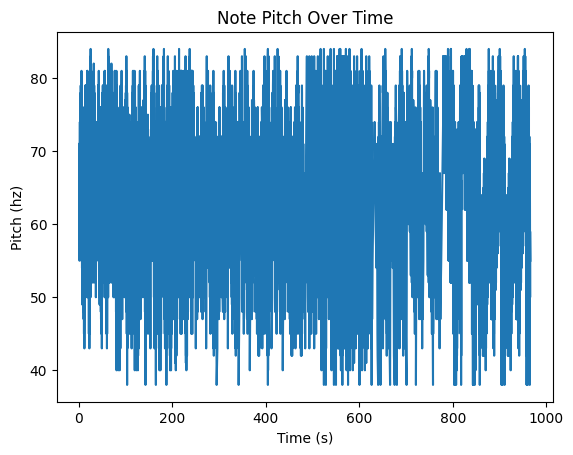

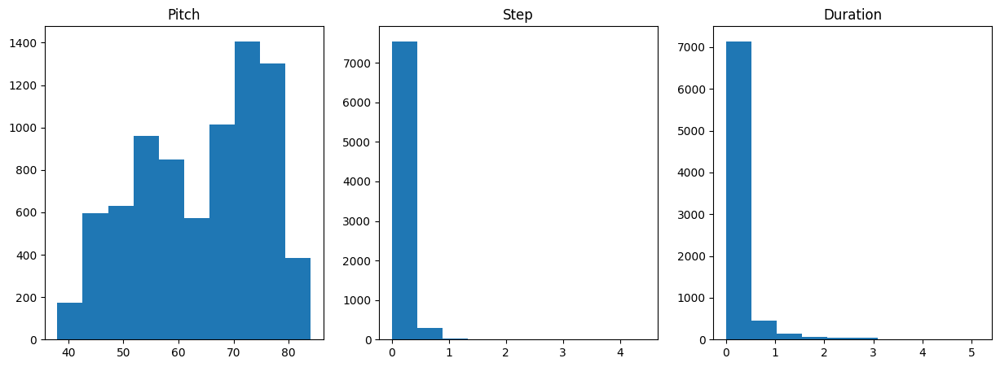

In [10]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_frequency(notes: pd.DataFrame):
    pitch = notes["pitch"].to_numpy()
    x = notes["start"].to_numpy()
    
    
    plt.title("Note Pitch Over Time")
    plt.xlabel("Time (s)")
    plt.ylabel("Pitch (hz)")
    
    plt.plot(x, pitch)
    
    plt.show()
    
    
def plot_note_distribution(notes: pd.DataFrame):
    pitch = notes["pitch"].to_numpy()
    step = notes["step"].to_numpy()
    duration = notes["duration"].to_numpy()
    
    plt.figure(figsize=[15, 5])
    
    sb = plt.subplot(1, 3, 1)
    
    sb.set_title("Pitch")
    plt.hist(pitch)
    
    sb = plt.subplot(1, 3, 2)
    
    sb.set_title("Step")
    plt.hist(step)
    
    sb = plt.subplot(1, 3, 3)
    sb.set_title("Duration")
    
    plt.hist(duration)
    
plot_frequency(raw_notes)
plot_note_distribution(raw_notes)

In [11]:
import scipy.io.wavfile as wavfile

# def create_midi(notes: pd.DataFrame, out_file: str, instrument_name: str):
#     out_midi = pretty_midi.PrettyMIDI()
#     instrument = pretty_midi.Instrument(program=pretty_midi.instrument_name_to_program(instrument_name))
    
#     out_midi.instruments.append(instrument)
    
#     new_notes = []
#     start = float(0)
#     for i, note in notes.iterrows():
#         end = start + note["step"]
#         # velocity = note["velocity"]
#         velocity = 0
#         pitch = int(note["pitch"])
#         new_note = pretty_midi.Note(velocity,pitch, start, end,)
#         new_notes.append(new_note)
#         start = end
        
#         instrument.notes.append(new_note)
    
#     out_midi.write(out_file)
    
#     return out_midi


def notes_to_midi(
  notes: pd.DataFrame,
  out_file: str, 
  instrument_name: str,
  velocity: int = 100,  # note loudness
) -> pretty_midi.PrettyMIDI:

  pm = pretty_midi.PrettyMIDI()
  instrument = pretty_midi.Instrument(
      program=pretty_midi.instrument_name_to_program(
          instrument_name))

  prev_start = 0
  for i, note in notes.iterrows():
    start = float(prev_start + note['step'])
    end = float(start + note['duration'])
    note = pretty_midi.Note(
        velocity=velocity,
        pitch=int(note['pitch']),
        start=start,
        end=end,
    )
    instrument.notes.append(note)
    prev_start = start
    
  pm.instruments.append(instrument)
  pm.write(out_file)
  return pm

midi = notes_to_midi(raw_notes, "test_outputs/MIDI_with_LSTM/test.midi", instrument_name, 100)

synth = midi.synthesize(_SAMPLING_RATE)
IPython.display.Audio(synth, rate=_SAMPLING_RATE)


In [12]:
n_files = 10 #len(filenames)

def getAllNotes():
    all_notes = []
    for f in range(n_files):
        pm = pretty_midi.PrettyMIDI(filenames[f])
    
        sorted_notes: list = sorted(pm.instruments[0].notes, key=lambda note: note.start)
        
        out = {}
        out["start"] = []
        out["end"] = []
        out["pitch"] = []
        out["step"] = []
        out["duration"] = []
        out["velocity"] = []
        
        previous_start = 0
        for note in sorted_notes:
            out["start"].append(note.start)
            out["end"].append(note.end)
            out["duration"].append(note.end - note.start)
            out["pitch"].append(note.pitch)
            out["step"].append(note.start - previous_start)
            out["velocity"].append(note.velocity)
            previous_start = note.start
            
        notes = pd.DataFrame({name: np.array(value) for name, value in out.items()})
        all_notes.append(notes)
        
    all_notes = pd.concat(all_notes)
    return all_notes
      
      
all_notes = getAllNotes()

all_notes.head()


,start,end,pitch,step,duration,velocity
0,1.092708,1.189583,71,1.092708,0.096875,60
1,1.279167,1.496875,55,0.186458,0.217708,44
2,1.288542,1.793750,71,0.009375,0.505208,54
3,1.463542,1.631250,59,0.175000,0.167708,55
4,1.633333,1.753125,62,0.169792,0.119792,52


In [13]:
import tensorflow as tf

key_order = ["pitch", "step", "duration", "velocity"]
# key_order: list[str] = all_notes.columns.to_list()

print(f"Key Order: {key_order}")
def create_note_sequences(dataset: tf.data.Dataset, sequence_length: int, vocab_size: int):

    windows = dataset.window(sequence_length + 1, shift=1, stride=1, drop_remainder=True)
    sequences = windows.flat_map(lambda x: x.batch(sequence_length + 1, drop_remainder=True))
    

    def scale_pitch(x):
        
        pitch_scale = float(vocab_size)
        step_scale = 1.0
        duration_scale = 1.0
        velocity_scale = 1.0
        
        return tf.divide(x, tf.constant([pitch_scale, step_scale, duration_scale, velocity_scale], dtype= tf.float64))

    
    def split_labels(sequences):
        inputs = sequences[:-1]
        labels_dense = sequences[-1]
        labels = {key:labels_dense[i] for i,key in enumerate(key_order)}
            
        return scale_pitch(inputs), labels


    return sequences.map(split_labels, tf.data.AUTOTUNE)


seq_length = 100
vocab_size = np.max(all_notes["pitch"].unique()) + 1
max_velocity = np.max(all_notes["velocity"]) + 1

notes_by_column = [all_notes[key].to_numpy() for key in key_order]
stacked_notes = np.stack(notes_by_column, axis=1)

print(stacked_notes.shape)
notes_ds = tf.data.Dataset.from_tensor_slices(stacked_notes)


seq_ds = create_note_sequences(notes_ds, seq_length, vocab_size)
seq_ds.element_spec
    

Key Order: ['pitch', 'step', 'duration', 'velocity']
(68137, 4)


(TensorSpec(shape=(100, 4), dtype=tf.float64, name=None),
 {'pitch': TensorSpec(shape=(), dtype=tf.float64, name=None),
  'step': TensorSpec(shape=(), dtype=tf.float64, name=None),
  'duration': TensorSpec(shape=(), dtype=tf.float64, name=None),
  'velocity': TensorSpec(shape=(), dtype=tf.float64, name=None)})

In [14]:
for seq, target in seq_ds.take(1):
    seq: tf.Tensor = seq
    print('sequence shape:', seq.shape)
    print('sequence elements (first 10):', seq[0: 10])
    print()
    print('target:', target)
    
batch_size = 64
buffer_size = len(all_notes)

training_ds = seq_ds.shuffle(buffer_size).batch(batch_size, drop_remainder=True).cache().prefetch(tf.data.AUTOTUNE)
    
training_ds.element_spec

sequence shape: (100, 4)
sequence elements (first 10): tf.Tensor(
[[6.69811321e-01 1.09270833e+00 9.68750000e-02 6.00000000e+01]
 [5.18867925e-01 1.86458333e-01 2.17708333e-01 4.40000000e+01]
 [6.69811321e-01 9.37500000e-03 5.05208333e-01 5.40000000e+01]
 [5.56603774e-01 1.75000000e-01 1.67708333e-01 5.50000000e+01]
 [5.84905660e-01 1.69791667e-01 1.19791667e-01 5.20000000e+01]
 [6.79245283e-01 1.53125000e-01 4.16666667e-02 7.60000000e+01]
 [6.32075472e-01 1.66666667e-02 1.96875000e-01 5.60000000e+01]
 [6.98113208e-01 1.80208333e-01 1.14583333e-01 6.80000000e+01]
 [5.37735849e-01 0.00000000e+00 5.39583333e-01 6.10000000e+01]
 [6.79245283e-01 5.41666667e-02 6.87500000e-02 7.70000000e+01]], shape=(10, 4), dtype=float64)

target: {'pitch': <tf.Tensor: shape=(), dtype=float64, numpy=75.0>, 'step': <tf.Tensor: shape=(), dtype=float64, numpy=0.09895833333333393>, 'duration': <tf.Tensor: shape=(), dtype=float64, numpy=0.19895833333333357>, 'velocity': <tf.Tensor: shape=(), dtype=float64, nump

(TensorSpec(shape=(64, 100, 4), dtype=tf.float64, name=None),
 {'pitch': TensorSpec(shape=(64,), dtype=tf.float64, name=None),
  'step': TensorSpec(shape=(64,), dtype=tf.float64, name=None),
  'duration': TensorSpec(shape=(64,), dtype=tf.float64, name=None),
  'velocity': TensorSpec(shape=(64,), dtype=tf.float64, name=None)})

In [15]:

import keras
# Encourawe positive outputs, setting negative values to high loss!
def mse_with_positive_presssure(y_true: tf.Tensor, y_pred: tf.Tensor):
    mse = tf.square(y_true - y_pred)
    positive_pressure = 10 * tf.maximum(-y_pred, 0.0)
    
    return tf.reduce_mean(mse + positive_pressure)

loss = {
    "pitch": keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    "step": mse_with_positive_presssure,
    "duration": mse_with_positive_presssure,
    "velocity": keras.losses.SparseCategoricalCrossentropy(from_logits=True)
}

learning_rate = 0.005

optimizer = keras.optimizers.Adam(learning_rate)

def create_model():

    input_shape = (seq_length, len(key_order))

    input_layer = keras.layers.Input(input_shape)
    lstm_layer = keras.layers.LSTM(vocab_size)(input_layer)
    lstm_layer = keras.layers.Reshape([vocab_size, 1])(lstm_layer)
    lstm_layer = keras.layers.LSTM(vocab_size)(lstm_layer)

    outputs = {
        "pitch": keras.layers.Dense(vocab_size, name = 'pitch')(lstm_layer),
        "step": keras.layers.Dense(1, name="step")(lstm_layer),
        "duration": keras.layers.Dense(1, name="duration")(lstm_layer),
        "velocity": keras.layers.Dense(max_velocity, name="velocity")(lstm_layer)
    }

    model = keras.Model(input_layer, outputs)

    model.compile(optimizer, loss)
    
    return model

model = create_model()
model.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 100, 4)]             0         []                            
                                                                                                  
 lstm (LSTM)                 (None, 106)                  47064     ['input_1[0][0]']             
                                                                                                  
 reshape (Reshape)           (None, 106, 1)               0         ['lstm[0][0]']                
                                                                                                  
 lstm_1 (LSTM)               (None, 106)                  45792     ['reshape[0][0]']             
                                                                                              

In [16]:
losses = model.evaluate(training_ds, return_dict=True)

# print(losses)


loss_weights = {key: 1 / losses[f"{key}_loss"] * (len(losses) - 1) for key in key_order}

weighted_losses = {key: loss_weights[key]*losses[f"{key}_loss"] for key in loss_weights}

print(losses)
print(loss_weights)
print(weighted_losses)


model.compile(optimizer, loss, loss_weights = loss_weights)


new_losses = model.evaluate(training_ds, return_dict=True)

print(new_losses)

1063/1063 [==============================] - 35s 27ms/step - loss: 9.7319 - duration_loss: 0.2618 - pitch_loss: 4.6642 - step_loss: 0.0498 - velocity_loss: 4.7561
{'loss': 9.73193073272705, 'duration_loss': 0.261801540851593, 'pitch_loss': 4.664182662963867, 'step_loss': 0.04981933906674385, 'velocity_loss': 4.756128311157227}
{'pitch': 0.8575993457036242, 'step': 80.2901057085709, 'duration': 15.278748883557844, 'velocity': 0.841020203474441}
{'pitch': 4.0, 'step': 4.0, 'duration': 4.0, 'velocity': 4.0}
1063/1063 [==============================] - 38s 35ms/step - loss: 16.0000 - duration_loss: 0.2618 - pitch_loss: 4.6642 - step_loss: 0.0498 - velocity_loss: 4.7561
{'loss': 16.0000057220459, 'duration_loss': 0.261801540851593, 'pitch_loss': 4.664182662963867, 'step_loss': 0.04981933906674385, 'velocity_loss': 4.756128311157227}


In [17]:
#model training time!

callbacks = [
    
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.ModelCheckpoint("checkpoints/MIDI_with_LSTM/checkpoint_{epoch}", save_weights_only=True),
    keras.callbacks.EarlyStopping(monitor="loss", patience=5, verbose=1, restore_best_weights=True)
]

# %%time

epochs = 1000

history = model.fit(training_ds, epochs=epochs, callbacks=callbacks)

Epoch 1/1000
   1063/Unknown - 128s 117ms/step - loss: 14.8668 - duration_loss: 0.1974 - pitch_loss: 4.1247 - step_loss: 0.0585 - velocity_loss: 4.3009WARNING:tensorflow:Learning rate reduction is conditioned on metric `val_loss` which is not available. Available metrics are: loss,duration_loss,pitch_loss,step_loss,velocity_loss,lr
1063/1063 [==============================] - 128s 117ms/step - loss: 14.8668 - duration_loss: 0.1974 - pitch_loss: 4.1247 - step_loss: 0.0585 - velocity_loss: 4.3009 - lr: 0.0050
Epoch 2/1000
 995/1063 [===========================>..] - ETA: 7s - loss: 12.4826 - duration_loss: 0.1490 - pitch_loss: 4.0631 - step_loss: 0.0400 - velocity_loss: 4.1746

KeyboardInterrupt: 

In [18]:
def predict_next_note(
    notes: np.ndarray, 
    model: tf.keras.Model, 
    temperature: float = 1.0) -> tuple[int, float, float]:
  """Generates a note as a tuple of (pitch, step, duration), using a trained sequence model."""

  assert temperature > 0

  # Add batch dimension
  inputs = tf.expand_dims(notes, 0)

  predictions = model.predict(inputs)
  pitch_logits = predictions['pitch']
  step = predictions['step']
  duration = predictions['duration']
  velocity_logits = predictions['velocity']

  pitch_logits /= temperature
  velocity_logits /= temperature
  pitch = tf.random.categorical(pitch_logits, num_samples=1)
  pitch = tf.squeeze(pitch, axis=-1)
  duration = tf.squeeze(duration, axis=-1)
  step = tf.squeeze(step, axis=-1)
  velocity = tf.random.categorical(velocity_logits, num_samples=1)
  velocity = tf.squeeze(velocity, axis = -1)

  # `step` and `duration` values should be non-negative
  step = tf.maximum(0, step)
  duration = tf.maximum(0, duration)
  # velocity = tf.maximum(0, velocity)

  return int(pitch), float(step), float(duration), int(velocity)

In [24]:
temperature = 1.1
num_predictions = 120


checkpoint_dir = "checkpoints/MIDI_with_LSTM"
def get_last_checkpoint():
    pattern = r'checkpoint_(\d+)\.'
    files = os.listdir(checkpoint_dir)
    checkpoints = [int(re.match(pattern, file).group(1)) if re.match(pattern, file) else -1 for file in files if file.startswith("checkpoint")]
    return max(checkpoints)

checkpoint_path = f"{checkpoint_dir}/checkpoint_{get_last_checkpoint()}"

model = create_model()
model.load_weights(checkpoint_path)

sample_notes = np.stack([raw_notes[key] for key in key_order], axis=1)

# The initial sequence of notes; pitch is normalized similar to training
# sequences
input_notes = (
    sample_notes[:seq_length] / np.array([vocab_size, 1, 1, 1]))

generated_notes = []
prev_start = 0
for _ in range(num_predictions):
  pitch, step, duration, velocity = predict_next_note(input_notes, model, temperature)
  start = prev_start + step
  end = start + duration
  input_note = (pitch, step, duration, velocity)
  generated_notes.append((*input_note, start, end))
  input_notes = np.delete(input_notes, 0, axis=0)
  input_notes = np.append(input_notes, np.expand_dims(input_note, 0), axis=0)
  prev_start = start

generated_notes = pd.DataFrame(
    generated_notes, columns=(*key_order, 'start', 'end'))


print(generated_notes.head())

1/1 [==============================] - 0s 19ms/step
   pitch      step  duration  velocity     start       end
0     65  0.151934  0.273008        88  0.151934  0.424942
1     86  0.068336  0.178432        63  0.220270  0.398702
2     73  0.068489  0.178570        66  0.288759  0.467328
3     47  0.067655  0.177408        74  0.356413  0.533822
4     31  0.066311  0.175188        72  0.422725  0.597913


In [26]:
out_file = 'predictions/MIDI_with_LSTM/output_gen.mid'
out_pm = notes_to_midi(
    generated_notes, out_file=out_file, instrument_name=instrument_name)

synth = out_pm.synthesize(_SAMPLING_RATE)
IPython.display.Audio(synth, rate=_SAMPLING_RATE)

def save_wav(audio, rate, filename):
    audio = (audio / np.max(audio))
    saveable = (audio * (2 ** 16 - 1)) - 2 ** 15
    saveable = saveable.astype(np.int16)
    wavfile.write(filename, rate, saveable)
    
save_wav(synth, _SAMPLING_RATE, "predictions/MIDI_with_LSTM/output_gen.wav")